In [ ]:
import numpy as np
import pandas as pd
import os
import glob
import time
import matplotlib.pyplot as plt
import cv2
import seaborn as sns
import shutil
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Activation,Dropout,Conv2D, MaxPooling2D,BatchNormalization, Average
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras import regularizers
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
import time
import shutil
from keras.models import Sequential
from keras import layers, models
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, Dropout
from tensorflow.keras.optimizers.legacy import Adam, SGD, Adamax
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!unzip /content/drive/MyDrive/project/archive.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/0/9684605R.png    
  inflating: train/0/9685238L.png    
  inflating: train/0/9685238R.png    
  inflating: train/0/9686617L.png    
  inflating: train/0/9686617R.png    
  inflating: train/0/9686777R.png    
  inflating: train/0/9686834L.png    
  inflating: train/0/9686834R.png    
  inflating: train/0/9686908L.png    
  inflating: train/0/9686908R.png    
  inflating: train/0/9687273L.png    
  inflating: train/0/9689906R.png    
  inflating: train/0/9690910L.png    
  inflating: train/0/9690910R.png    
  inflating: train/0/9691359L.png    
  inflating: train/0/9691359R.png    
  inflating: train/0/9692163L.png    
  inflating: train/0/9692604L.png    
  inflating: train/0/9692604R.png    
  inflating: train/0/9692923R.png    
  inflating: train/0/9693364R.png    
  inflating: train/0/9693599L.png    
  inflating: train/0/9693599R.png    
  inflating: train/0/9694101L.png    
  inflating: train/0/9694101R.png    

In [ ]:
train_path = '/content/train'
test_path = '/content/test'
valid_path = '/content/val'
random_path = '/content/auto_test'
list_of_classes=['Healthy', 'Doubtful', 'Minimal', 'Moderate', 'Severe']

In [ ]:
for d in [train_path, test_path, valid_path]:
    filepaths = []
    labels=[]
    classlist=os.listdir(d)
    for klass in classlist:
        intklass=int(klass)
        label=list_of_classes[intklass]
        classpath=os.path.join(d, klass)
        flist=os.listdir(classpath)
        for f in flist:
            fpath=os.path.join(classpath,f)
            filepaths.append(fpath)
            labels.append(label)
    Fseries=pd.Series(filepaths, name='filepaths')
    Lseries=pd.Series(labels, name='labels')
    pdf=pd.concat([Fseries, Lseries], axis=1)
    if d == test_path:
        test_df=pdf
    elif d == valid_path:
        valid_df=pdf
    else:
        train_df=pdf
print('train_df lenght: ', len(train_df), '  test_df length: ', len(test_df), '  valid_df length: ', len(valid_df))
# get the number of classes and the images count for each class in train_df
classes=sorted(list(train_df['labels'].unique()))
class_count = len(classes)
print('The number of classes in the dataset is: ', class_count)
groups=train_df.groupby('labels')
print('{0:^30s} {1:^13s}'.format('CLASS', 'IMAGE COUNT'))
countlist=[]
classlist=[]
for label in sorted(list(train_df['labels'].unique())):
    group=groups.get_group(label)
    countlist.append(len(group))
    classlist.append(label)
    print('{0:^30s} {1:^13s}'.format(label, str(len(group))))

# get the classes with the minimum and maximum number of train images
max_value=np.max(countlist)
max_index=countlist.index(max_value)
max_class=classlist[max_index]
min_value=np.min(countlist)
min_index=countlist.index(min_value)
min_class=classlist[min_index]
print(max_class, ' has the most images= ',max_value, ' ', min_class, ' has the least images= ', min_value)
# lets get the average height and width of a sample of the train images
ht=0
wt=0
# select 100 random samples of train_df
train_df_sample=train_df.sample(n=100, random_state=123,axis=0)
for i in range (len(train_df_sample)):
    fpath=train_df_sample['filepaths'].iloc[i]
    img=plt.imread(fpath)
    shape=img.shape
    ht += shape[0]
    wt += shape[1]
print('average height= ', ht//100, ' average width= ', wt//100, 'aspect ratio= ', ht/wt)

train_df lenght:  5778   test_df length:  1656   valid_df length:  826
The number of classes in the dataset is:  5
            CLASS               IMAGE COUNT 
           Doubtful                1046     
           Healthy                 2286     
           Minimal                 1516     
           Moderate                 757     
            Severe                  173     
Healthy  has the most images=  2286   Severe  has the least images=  173
average height=  224  average width=  224 aspect ratio=  1.0


In [ ]:
def trim(df, max_samples, min_samples, column):
    df=df.copy()
    groups=df.groupby(column)
    trimmed_df = pd.DataFrame(columns = df.columns)
    groups=df.groupby(column)
    for label in df[column].unique():
        group=groups.get_group(label)
        count=len(group)
        if count > max_samples:
            sampled_group=group.sample(n=max_samples, random_state=123,axis=0)
            trimmed_df=pd.concat([trimmed_df, sampled_group], axis=0)
        else:
            if count>=min_samples:
                sampled_group=group
                trimmed_df=pd.concat([trimmed_df, sampled_group], axis=0)
    print('after trimming, the maximum samples in any class is now ',max_samples, ' and the minimum samples in any class is ', min_samples)
    return trimmed_df

max_samples=500 # since each class has more than 200 images all classes will be trimmed to have 200 images per class
min_samples=173
column='labels'
train_df= trim(train_df, max_samples, min_samples, column)

after trimming, the maximum samples in any class is now  500  and the minimum samples in any class is  173


In [ ]:
def balance(df, n, working_dir, img_size):
    df=df.copy()
    print('Initial length of dataframe is ', len(df))
    aug_dir=os.path.join(working_dir, 'aug')
    if os.path.isdir(aug_dir):
        shutil.rmtree(aug_dir)
    os.mkdir(aug_dir)
    for label in df['labels'].unique():
        dir_path=os.path.join(aug_dir,label)
        os.mkdir(dir_path)
    # create and store the augmented images
    total=0
    gen=ImageDataGenerator(horizontal_flip=True,  rotation_range=20, width_shift_range=.2,height_shift_range=.2, zoom_range=.2)
    groups=df.groupby('labels')
    for label in df['labels'].unique():
        group=groups.get_group(label)
        sample_count=len(group)
        if sample_count< n:
            aug_img_count=0
            delta=n - sample_count
            target_dir=os.path.join(aug_dir, label)  # define where to write the images
            msg='{0:40s} for class {1:^30s} creating {2:^5s} augmented images'.format(' ', label, str(delta))
            print(msg, '\r', end='')
            aug_gen=gen.flow_from_dataframe( group,  x_col='filepaths', y_col=None, target_size=img_size,
                                            class_mode=None, batch_size=1, shuffle=False,
                                            save_to_dir=target_dir, save_prefix='aug-', color_mode='rgb',
                                            save_format='jpg')
            while aug_img_count<delta:
                images=next(aug_gen)
                aug_img_count += len(images)
            total +=aug_img_count
    print('Total Augmented images created= ', total)
    # create aug_df and merge with train_df to create composite training set ndf
    aug_fpaths=[]
    aug_labels=[]
    classlist=os.listdir(aug_dir)
    for klass in classlist:
        classpath=os.path.join(aug_dir, klass)
        flist=os.listdir(classpath)
        for f in flist:
          fpath=os.path.join(classpath,f)
          aug_fpaths.append(fpath)
          aug_labels.append(klass)
    Fseries=pd.Series(aug_fpaths, name='filepaths')
    Lseries=pd.Series(aug_labels, name='labels')
    aug_df=pd.concat([Fseries, Lseries], axis=1)
    df=pd.concat([df,aug_df], axis=0).reset_index(drop=True)
    print('Length of augmented dataframe is now ', len(df))
    return df

n=500
working_dir=r'./'
img_size=(224,224)
train_df=balance(train_df, n, working_dir, img_size)

Initial length of dataframe is  2173
Found 173 validated image filenames.
Total Augmented images created=  327
Length of augmented dataframe is now  2500


In [ ]:
def relabel(label_in):
    if label_in =='Healthy' or label_in == 'Doubtful' or label_in =='Minimal':
        label='Healthy'
    else:
        label=label_in
    return label


for df in [train_df, test_df, valid_df]:
    for i in range (len(df)):
        label=df['labels'].iloc[i]
        new_label=relabel(label)
        df['labels'].iloc[i]=new_label
print (train_df['labels'].value_counts())

max_samples=500
min_samples=500
column='labels'
train_df= trim(train_df, max_samples, min_samples, column)

Healthy     1500
Severe       500
Moderate     500
Name: labels, dtype: int64
after trimming, the maximum samples in any class is now  500  and the minimum samples in any class is  500


In [ ]:
batch_size=20
img_size=(224,224)
trgen=ImageDataGenerator(horizontal_flip=True,rotation_range=20 )
t_and_v_gen=ImageDataGenerator()
msg='{0:70s} for train generator'.format(' ')
print(msg, '\r', end='')
train_gen=trgen.flow_from_dataframe(train_df, x_col='filepaths', y_col='labels', target_size=img_size,
                                   class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)
msg='{0:70s} for valid generator'.format(' ')
print(msg, '\r', end='')
valid_gen=t_and_v_gen.flow_from_dataframe(valid_df, x_col='filepaths', y_col='labels', target_size=img_size,
                                   class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=batch_size)

length=len(test_df)
test_batch_size=sorted([int(length/n) for n in range(1,length+1) if length % n ==0 and length/n<=80],reverse=True)[0]
test_steps=int(length/test_batch_size)
msg='{0:70s} for test generator'.format(' ')
print(msg, '\r', end='')
test_gen=t_and_v_gen.flow_from_dataframe(test_df, x_col='filepaths', y_col='labels', target_size=img_size,
                                   class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=test_batch_size)

classes=list(train_gen.class_indices.keys())
class_indices=list(train_gen.class_indices.values())
class_count=len(classes)
labels=test_gen.labels
print ( 'test batch size: ' ,test_batch_size, '  test steps: ', test_steps, ' number of classes : ', class_count)

Found 1500 validated image filenames belonging to 3 classes.
Found 826 validated image filenames belonging to 3 classes.
Found 1656 validated image filenames belonging to 3 classes.
test batch size:  72   test steps:  23  number of classes :  3


In [ ]:
from tensorflow.keras.models import load_model
# Load the best saved model
model1 = load_model('/content/drive/MyDrive/Colab Notebooks/zkneeEffNetB5_1.h5')
model2 = load_model('/content/drive/MyDrive/Colab Notebooks/zDenseNet_1.h5')
model3 = load_model('/content/drive/MyDrive/Colab Notebooks/zInceptionV3_1.h5')
model4 = load_model('/content/drive/MyDrive/Colab Notebooks/zMobileNet2_1.h5')

In [ ]:
def predictor(test_gen, test_steps, model):
    y_pred= []
    y_true=test_gen.labels
    classes=list(test_gen.class_indices.keys())
    class_count=len(classes)
    errors=0
    preds=model.predict(test_gen, verbose=1)
    tests=len(preds)
    for i, p in enumerate(preds):
        pred_index=np.argmax(p)
        true_index=test_gen.labels[i]  # labels are integer values
        if pred_index != true_index: # a misclassification has occurred
            errors=errors + 1
            file=test_gen.filenames[i]
        y_pred.append(pred_index)

    acc=( 1-errors/tests) * 100
    print(f'there were {errors} errors in {tests} tests for an accuracy of {acc:6.2f}')

In [ ]:
model1._name = "model1"
model2._name = "model2"
model3._name = "model3"
model4._name = "model4"
input_tensor = Input(shape=(224, 224, 3))
output_tensor1 = model1(input_tensor)
output_tensor2 = model2(input_tensor)
output_tensor3 = model3(input_tensor)
output_tensor4 = model4(input_tensor)

output_tensor = Average()([output_tensor1, output_tensor2, output_tensor3, output_tensor4])
# output_tensor = Average()([output_tensor1, output_tensor2])

In [ ]:
ensemble_model = Model(inputs=input_tensor, outputs=output_tensor)
lr=.001
ensemble_model.compile(Adamax(learning_rate=lr), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
class LR_ASK(keras.callbacks.Callback):
    def __init__ (self, model, epochs,  ask_epoch): # initialization of the callback
        super(LR_ASK, self).__init__()
        self.model=model
        self.ask_epoch=ask_epoch
        self.epochs=epochs
        self.ask=True # if True query the user on a specified epoch
        self.lowest_vloss=np.inf
        self.best_weights=self.model.get_weights() # set best weights to model's initial weights
        self.best_epoch=1


    def on_train_begin(self, logs=None): # this runs on the beginning of training
        if self.ask_epoch == 0:
            print('you set ask_epoch = 0, ask_epoch will be set to 1', flush=True)
            self.ask_epoch=1
        if self.ask_epoch >= self.epochs: # you are running for epochs but ask_epoch>epochs
            print('ask_epoch >= epochs, will train for ', epochs, ' epochs', flush=True)
            self.ask=False # do not query the user
        if self.epochs == 1:
            self.ask=False # running only for 1 epoch so do not query user
        else:
            print('Training will proceed until epoch', ask_epoch,' then you will be asked to')
            print(' enter H to halt training or enter an integer for how many more epochs to run then be asked again')
        self.start_time= time.time() # set the time at which training started

    def on_train_end(self, logs=None):   # runs at the end of training
        print('loading model with weights from epoch ', self.best_epoch)
        self.model.set_weights(self.best_weights) # set the weights of the model to the best weights
        tr_duration=time.time() - self.start_time   # determine how long the training cycle lasted
        hours = tr_duration // 3600
        minutes = (tr_duration - (hours * 3600)) // 60
        seconds = tr_duration - ((hours * 3600) + (minutes * 60))
        msg = f'training elapsed time was {str(hours)} hours, {minutes:4.1f} minutes, {seconds:4.2f} seconds)'
        print (msg, flush=True) # print out training duration time

    def on_epoch_end(self, epoch, logs=None):  # method runs on the end of each epoch
        v_loss=logs.get('val_loss')  # get the validation loss for this epoch
        if v_loss< self.lowest_vloss:
            self.lowest_vloss=v_loss
            self.best_weights=self.model.get_weights() # set best weights to model's initial weights
            self.best_epoch=epoch + 1
            print (f'\n validation loss of {v_loss:7.4f} is below lowest loss, saving weights from epoch {str(epoch + 1):3s} as best weights')
        else:
            print (f'\n validation loss of {v_loss:7.4f} is above lowest loss of {self.lowest_vloss:7.4f} keeping weights from epoch {str(self.best_epoch)} as best weights')

        if self.ask: # are the conditions right to query the user?
            if epoch + 1 ==self.ask_epoch: # is this epoch the one for quering the user?
                print('\n Enter H to end training or  an integer for the number of additional epochs to run then ask again')
                ans=input()

                if ans == 'H' or ans =='h' or ans == '0': # quit training for these conditions
                    print ('you entered ', ans, ' Training halted on epoch ', epoch+1, ' due to user input\n', flush=True)
                    self.model.stop_training = True # halt training
                else: # user wants to continue training
                    self.ask_epoch += int(ans)
                    if self.ask_epoch > self.epochs:
                        print('\nYou specified maximum epochs of as ', self.epochs, ' cannot train for ', self.ask_epoch, flush =True)
                    else:
                        print ('you entered ', ans, ' Training will continue to epoch ', self.ask_epoch, flush=True)
                        lr=float(tf.keras.backend.get_value(self.model.optimizer.lr)) # get the current learning rate
                        print(f'current LR is  {lr:7.5f}  hit enter to keep  this LR or enter a new LR')
                        ans=input(' ')
                        if ans =='':
                            print (f'keeping current LR of {lr:7.5f}')
                        else:
                            new_lr=float(ans)
                            tf.keras.backend.set_value(self.model.optimizer.lr, new_lr) # set the learning rate in the optimizer
                            print(' changing LR to ', ans)

In [ ]:
def predictor(test_gen, test_steps, model):
    y_pred= []
    y_true=test_gen.labels
    classes=list(test_gen.class_indices.keys())
    class_count=len(classes)
    errors=0
    preds=model.predict(test_gen, verbose=1)
    tests=len(preds)
    for i, p in enumerate(preds):
        pred_index=np.argmax(p)
        true_index=test_gen.labels[i]  # labels are integer values
        if pred_index != true_index: # a misclassification has occurred
            errors=errors + 1
            file=test_gen.filenames[i]
        y_pred.append(pred_index)

    acc=( 1-errors/tests) * 100
    print(f'there were {errors} errors in {tests} tests for an accuracy of {acc:6.2f}')
    ypred=np.array(y_pred)
    ytrue=np.array(y_true)
    if class_count <=30:
        cm = confusion_matrix(ytrue, ypred)
        # plot the confusion matrix
        plt.figure(figsize=(12, 8))
        sns.heatmap(cm, annot=True, vmin=0, fmt='g', cmap='Blues', cbar=False)
        plt.xticks(np.arange(class_count)+.5, classes, rotation=90)
        plt.yticks(np.arange(class_count)+.5, classes, rotation=0)
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        plt.title("Confusion Matrix")
        plt.show()
    clr = classification_report(y_true, y_pred, target_names=classes, digits= 4) # create classification report
    print("Classification Report:\n----------------------\n", clr)
    return errors, tests,y_pred

In [ ]:
epochs=50
ask_epoch=50
ask=LR_ASK(ensemble_model, epochs,  ask_epoch)
callbacks=[ask]

In [ ]:
history = ensemble_model.fit(x=train_gen,  epochs=epochs, verbose=1, callbacks=callbacks,  validation_data=valid_gen,
               validation_steps=None,  shuffle=False,  initial_epoch=0
)

ask_epoch >= epochs, will train for  50  epochs
Training will proceed until epoch 50  then you will be asked to
 enter H to halt training or enter an integer for how many more epochs to run then be asked again
Epoch 1/50
75/75 [==============================] - ETA: 0s - loss: 0.5588 - accuracy: 0.9513
 validation loss of  1.5547 is below lowest loss, saving weights from epoch 1   as best weights
75/75 [==============================] - 180s 2s/step - loss: 0.5588 - accuracy: 0.9513 - val_loss: 1.5547 - val_accuracy: 0.8874
Epoch 2/50
75/75 [==============================] - ETA: 0s - loss: 0.4049 - accuracy: 0.9760
 validation loss of  0.6191 is below lowest loss, saving weights from epoch 2   as best weights
75/75 [==============================] - 96s 1s/step - loss: 0.4049 - accuracy: 0.9760 - val_loss: 0.6191 - val_accuracy: 0.8729
Epoch 3/50
75/75 [==============================] - ETA: 0s - loss: 0.3813 - accuracy: 0.9793
 validation loss of  0.4489 is below lowest loss, saving 

23/23 [==============================] - 43s 808ms/step
there were 97 errors in 1656 tests for an accuracy of  94.14


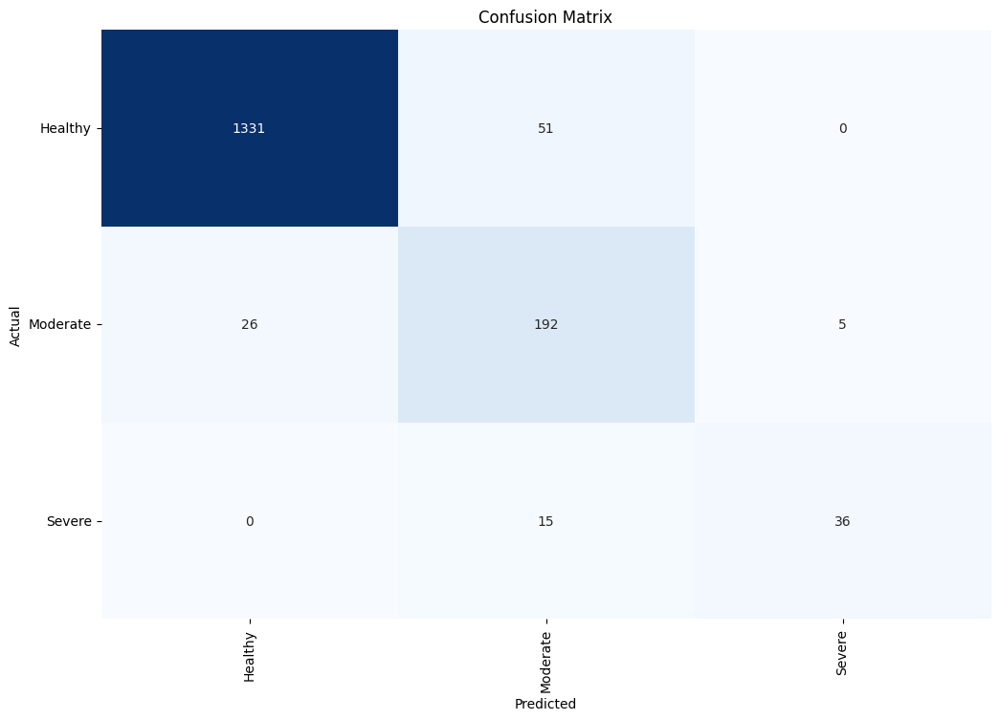

Classification Report:
----------------------
               precision    recall  f1-score   support

     Healthy     0.9808    0.9631    0.9719      1382
    Moderate     0.7442    0.8610    0.7983       223
      Severe     0.8780    0.7059    0.7826        51

    accuracy                         0.9414      1656
   macro avg     0.8677    0.8433    0.8509      1656
weighted avg     0.9458    0.9414    0.9427      1656



In [ ]:
errors, tests,y_pred1=predictor(test_gen, test_steps, ensemble_model)

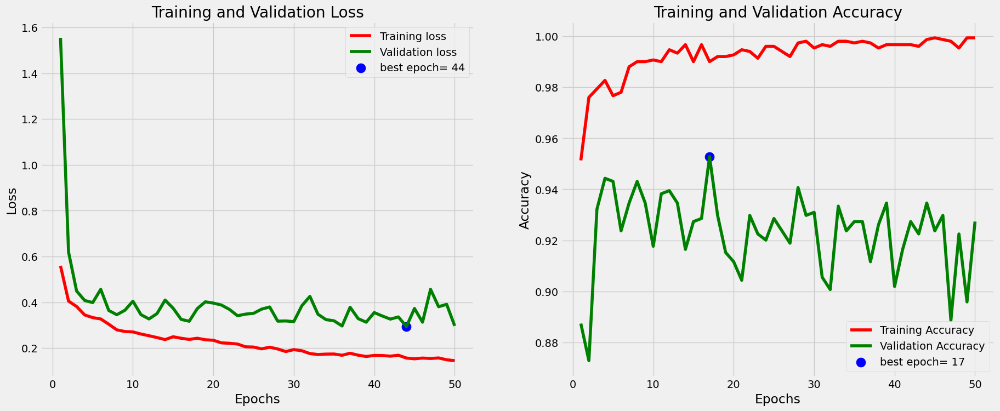

In [ ]:
def tr_plot(tr_data, start_epoch):
    #Plot the training and validation data
    tacc=tr_data.history['accuracy']
    tloss=tr_data.history['loss']
    vacc=tr_data.history['val_accuracy']
    vloss=tr_data.history['val_loss']
    Epoch_count=len(tacc)+ start_epoch
    Epochs=[]
    for i in range (start_epoch ,Epoch_count):
        Epochs.append(i+1)
    index_loss=np.argmin(vloss)#  this is the epoch with the lowest validation loss
    val_lowest=vloss[index_loss]
    index_acc=np.argmax(vacc)
    acc_highest=vacc[index_acc]
    plt.style.use('fivethirtyeight')
    sc_label='best epoch= '+ str(index_loss+1 +start_epoch)
    vc_label='best epoch= '+ str(index_acc + 1+ start_epoch)
    fig,axes=plt.subplots(nrows=1, ncols=2, figsize=(20,8))
    axes[0].plot(Epochs,tloss, 'r', label='Training loss')
    axes[0].plot(Epochs,vloss,'g',label='Validation loss' )
    axes[0].scatter(index_loss+1 +start_epoch,val_lowest, s=150, c= 'blue', label=sc_label)
    axes[0].set_title('Training and Validation Loss')
    axes[0].set_xlabel('Epochs')
    axes[0].set_ylabel('Loss')
    axes[0].legend()
    axes[1].plot (Epochs,tacc,'r',label= 'Training Accuracy')
    axes[1].plot (Epochs,vacc,'g',label= 'Validation Accuracy')
    axes[1].scatter(index_acc+1 +start_epoch,acc_highest, s=150, c= 'blue', label=vc_label)
    axes[1].set_title('Training and Validation Accuracy')
    axes[1].set_xlabel('Epochs')
    axes[1].set_ylabel('Accuracy')
    axes[1].legend()
    plt.tight_layout
    plt.show()

tr_plot(history,0)

ROC AUC score: 0.8976504770993751


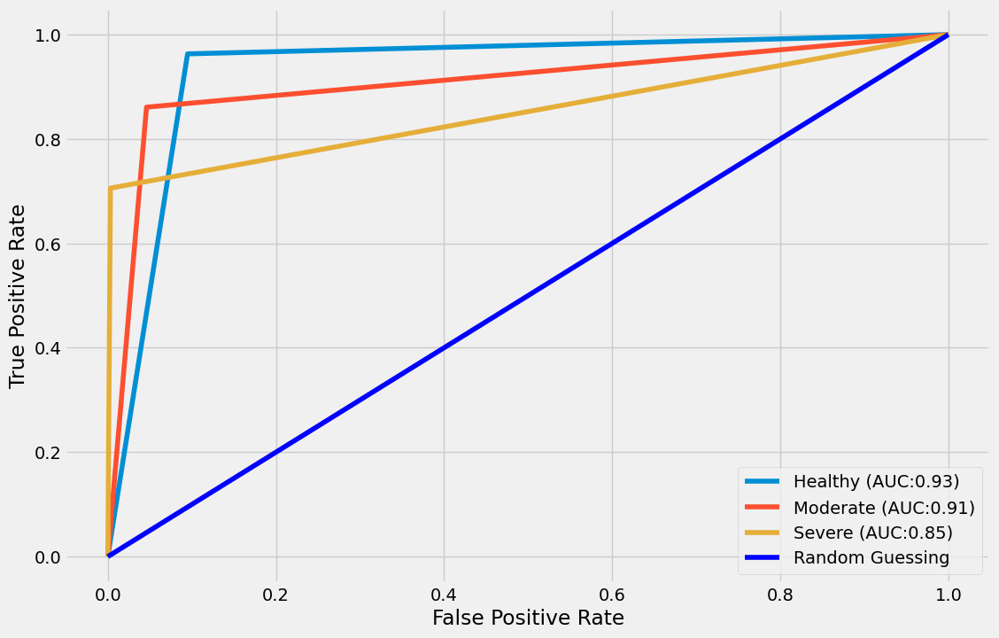

In [ ]:
def roc_cur234():
  y_train="/content/train"
  target= ['Healthy', 'Moderate', 'Severe']

  # set plot figure size
  fig, c_ax = plt.subplots(1,1, figsize = (12, 8))

  # function for scoring roc auc score for multi-class
  def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
      lb = LabelBinarizer()
      lb.fit(y_test)
      y_test = lb.transform(y_test)
      y_pred = lb.transform(y_pred)

      for (idx, c_label) in enumerate(target):
          fpr, tpr, thresholds = roc_curve(y_test[:,idx].astype(int), y_pred[:,idx])
          c_ax.plot(fpr, tpr, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
      c_ax.plot(fpr, fpr, 'b-', label = 'Random Guessing')
      return roc_auc_score(y_test, y_pred, average=average)


  print('ROC AUC score:', multiclass_roc_auc_score(test_gen.labels,y_pred1))

  c_ax.legend()
  c_ax.set_xlabel('False Positive Rate')
  c_ax.set_ylabel('True Positive Rate')
  plt.show()
roc_cur234()

In [ ]:
# Install the 'keract' package
!pip install keract

# Import necessary libraries
from keras.applications.vgg16 import VGG16, preprocess_input
from keras.preprocessing.image import load_img, img_to_array
from keract import display_activations, get_activations
import matplotlib.pyplot as plt

# Load a pre-trained VGG16 model
model = VGG16(weights='imagenet', include_top=True)


553467096/553467096 [==============================] - 5s 0us/step


Transfer learning detected. Model will be compiled with ("categorical_crossentropy", "adam").
If you want to change the default behaviour, then do in python:
model.name = ""
Then compile your model with whatever loss you want: https://keras.io/models/model/#compile.
If you want to get rid of this message, add this line before calling keract:
model.compile(loss="categorical_crossentropy", optimizer="adam")
input_2 (1, 224, 224, 3) 


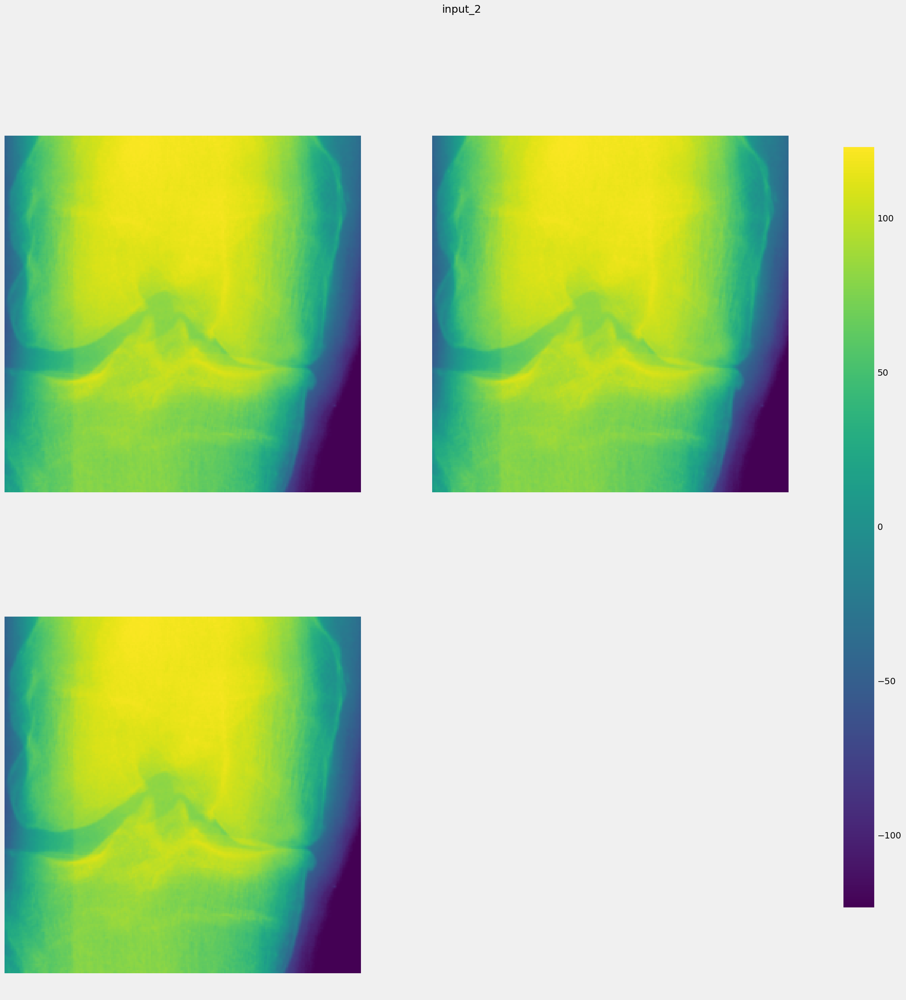

block1_conv1 (1, 224, 224, 64) 


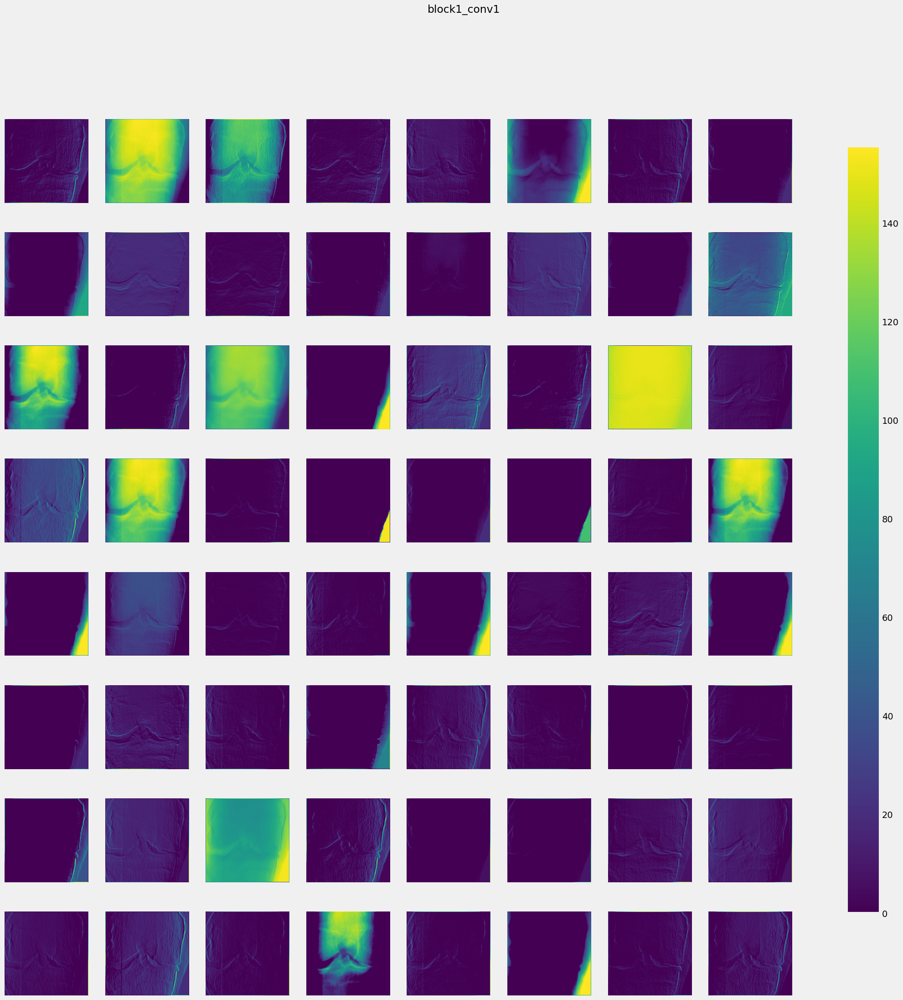

block1_conv2 (1, 224, 224, 64) 


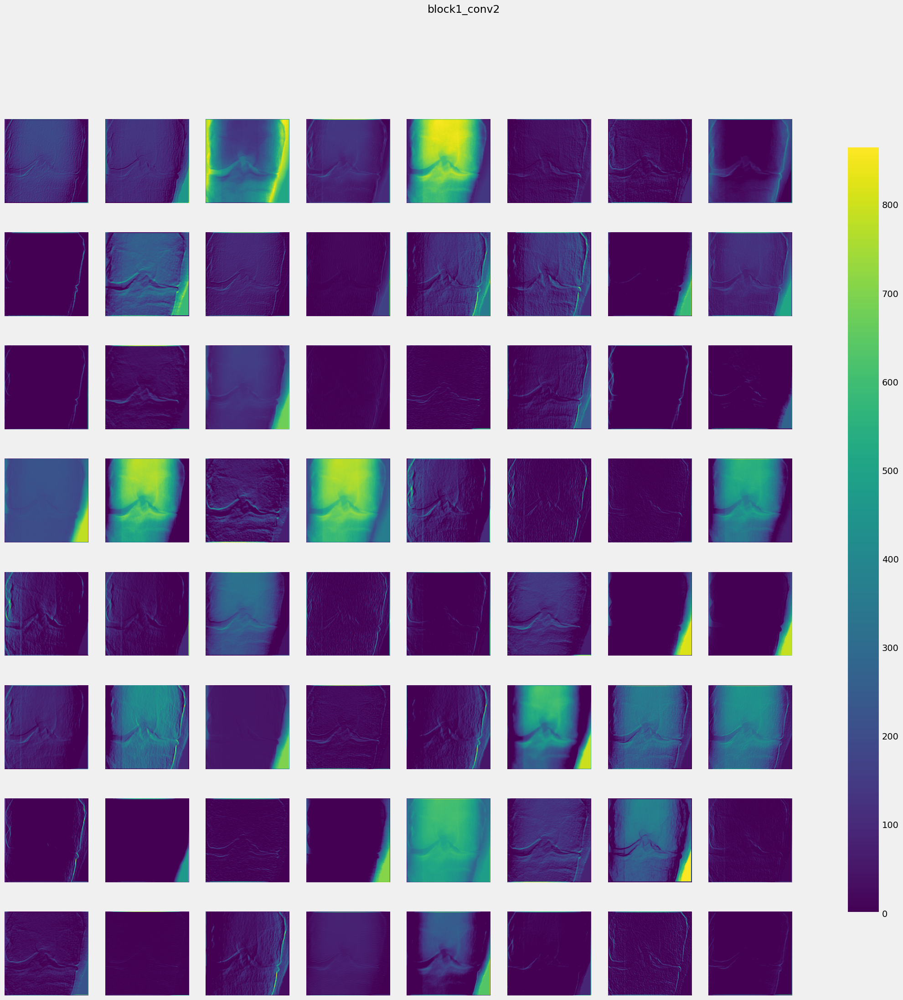

block1_pool (1, 112, 112, 64) 


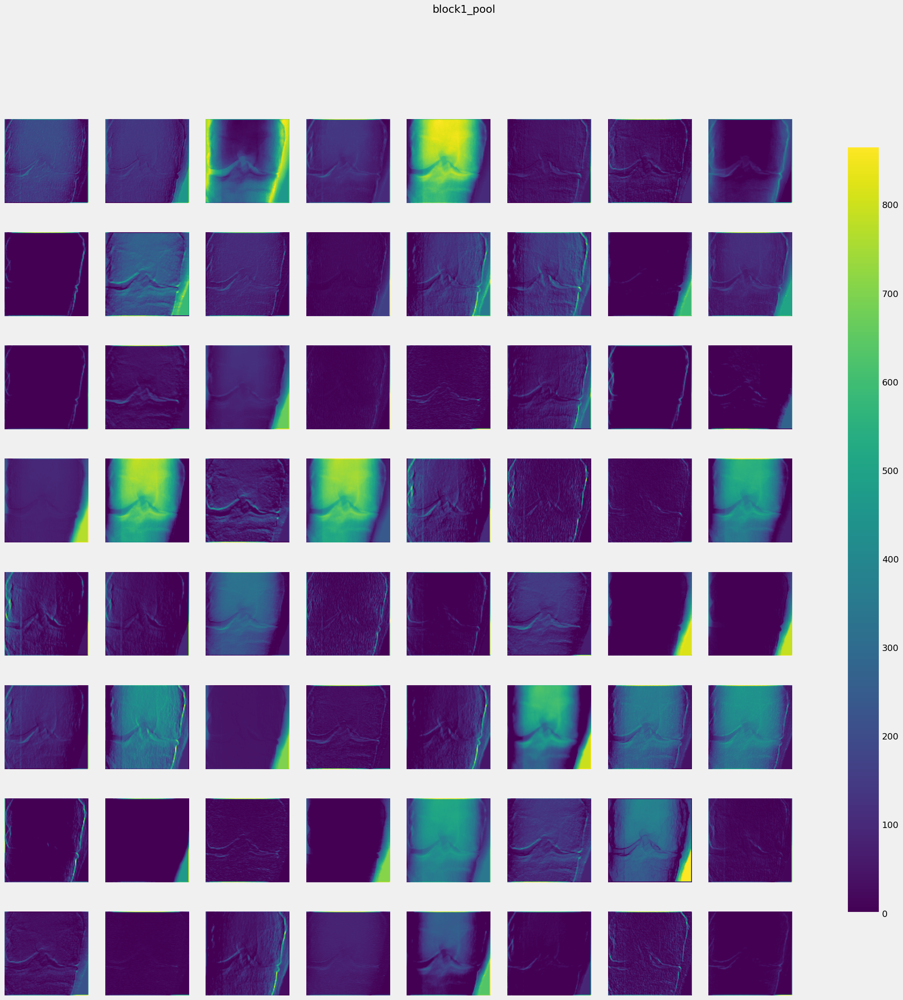

block2_conv1 (1, 112, 112, 128) 


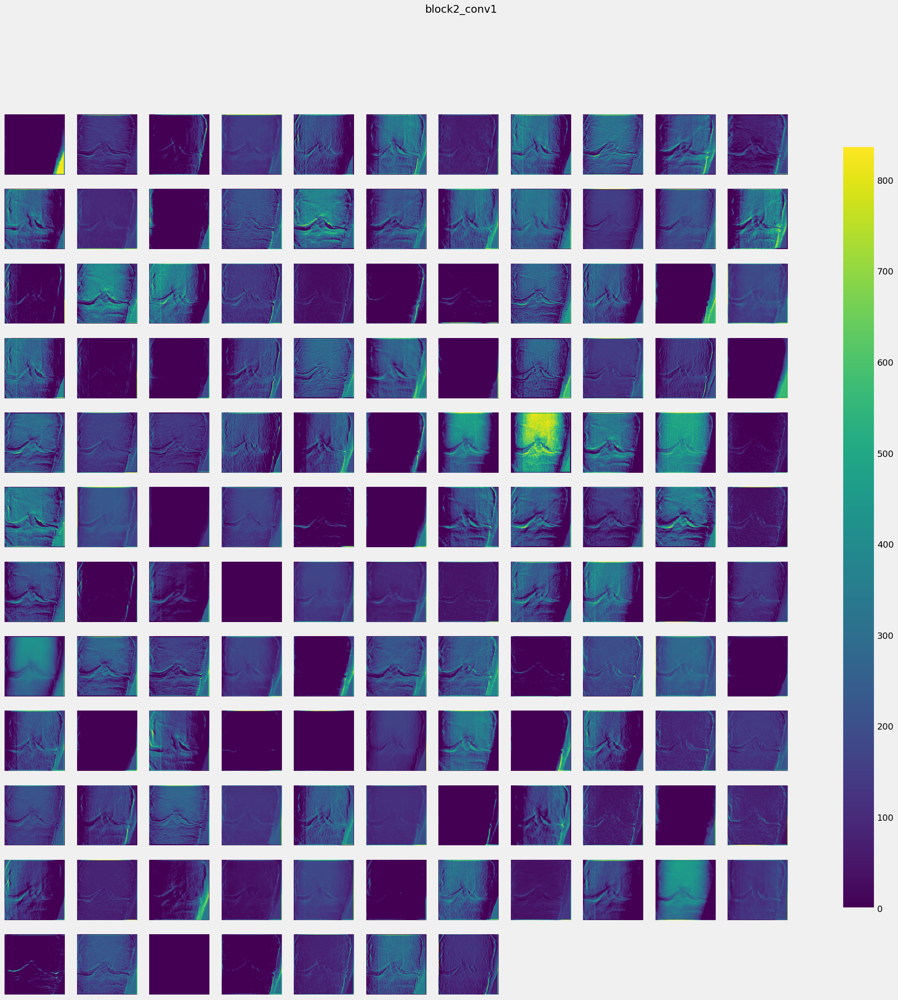

block2_conv2 (1, 112, 112, 128) 


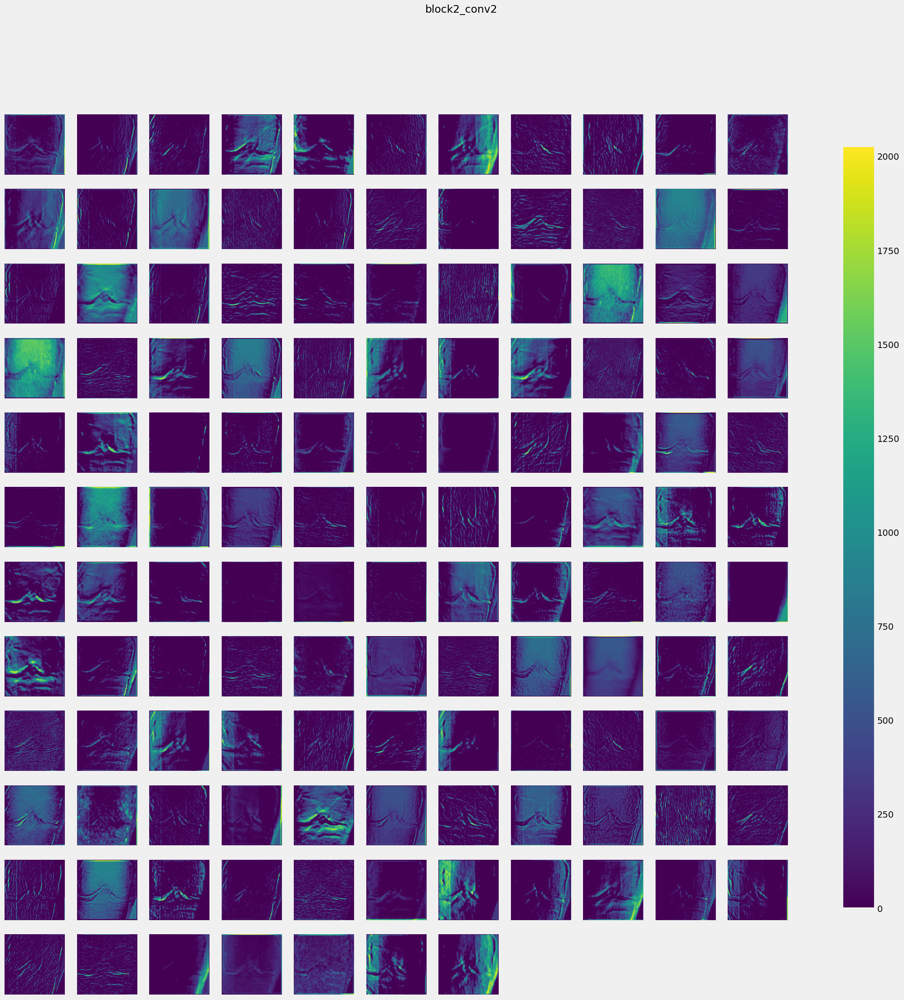

block2_pool (1, 56, 56, 128) 


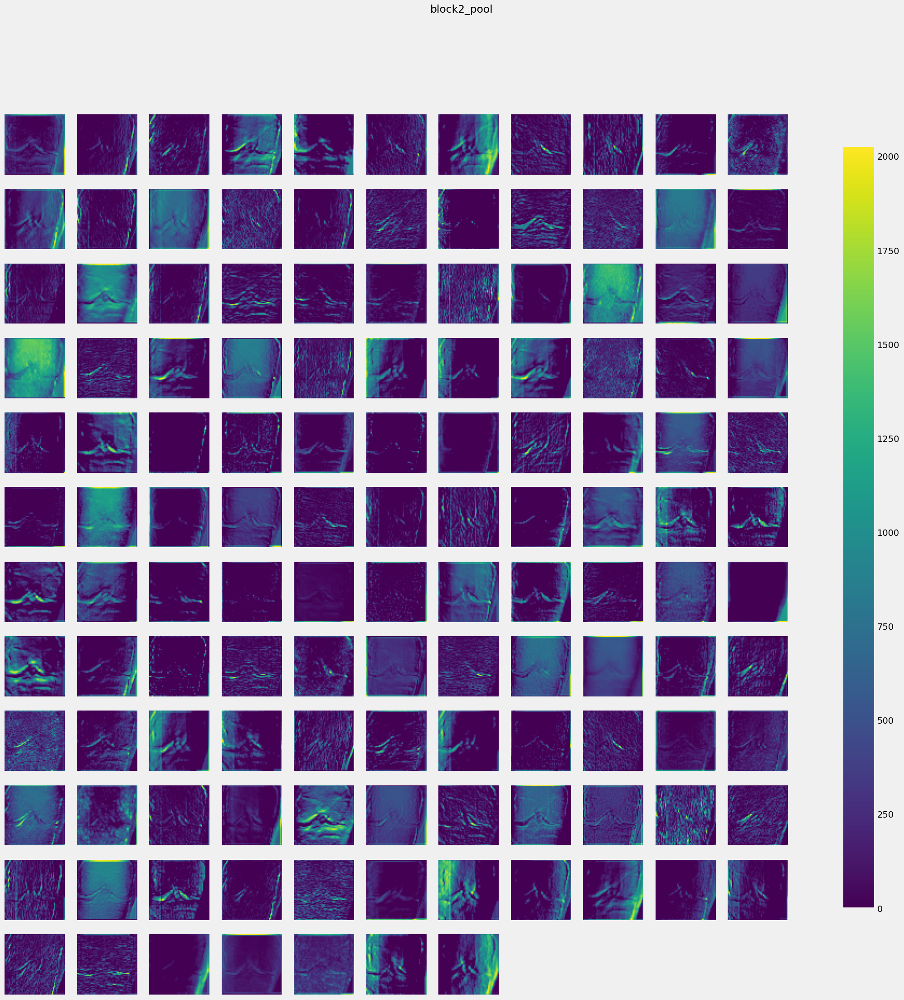

block3_conv1 (1, 56, 56, 256) 


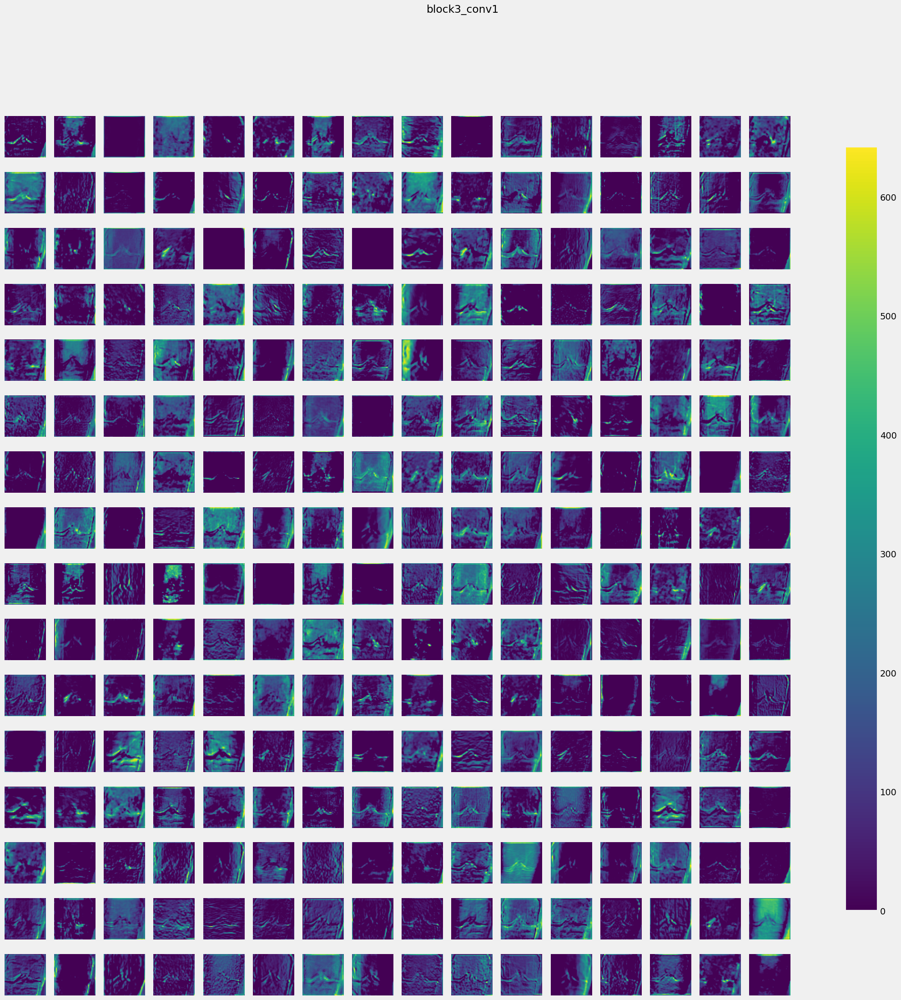

block3_conv2 (1, 56, 56, 256) 


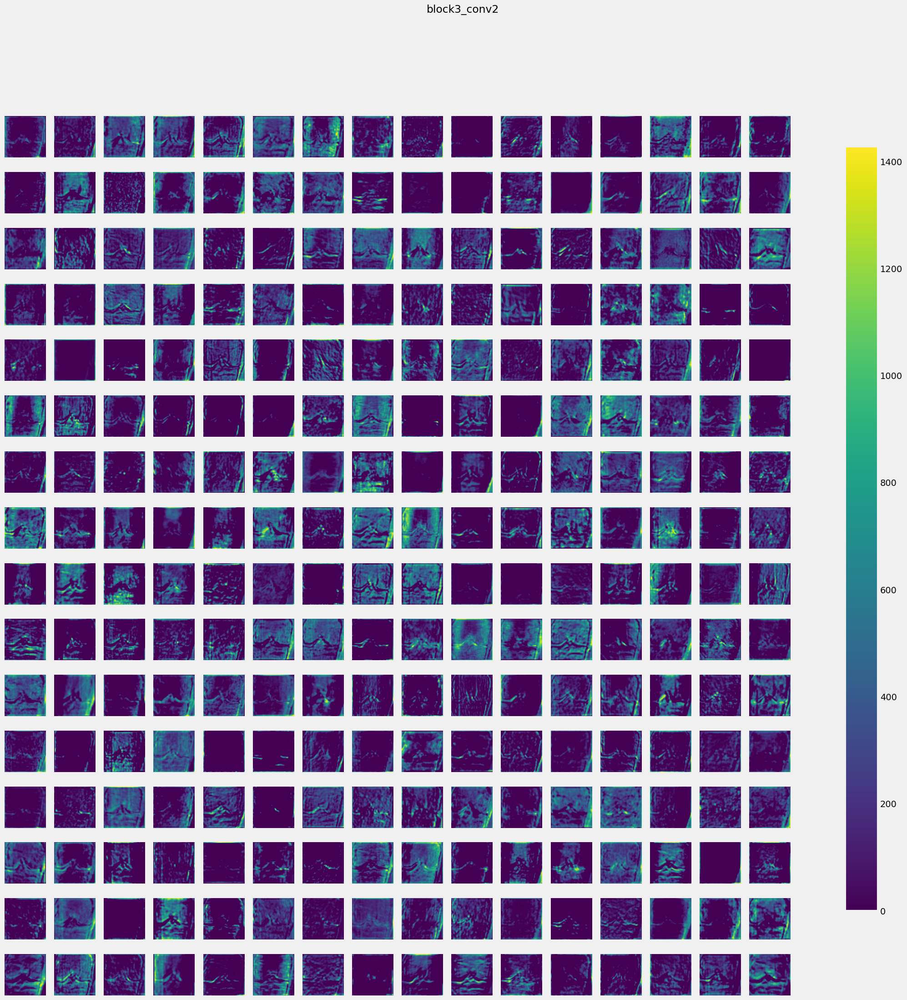

block3_conv3 (1, 56, 56, 256) 


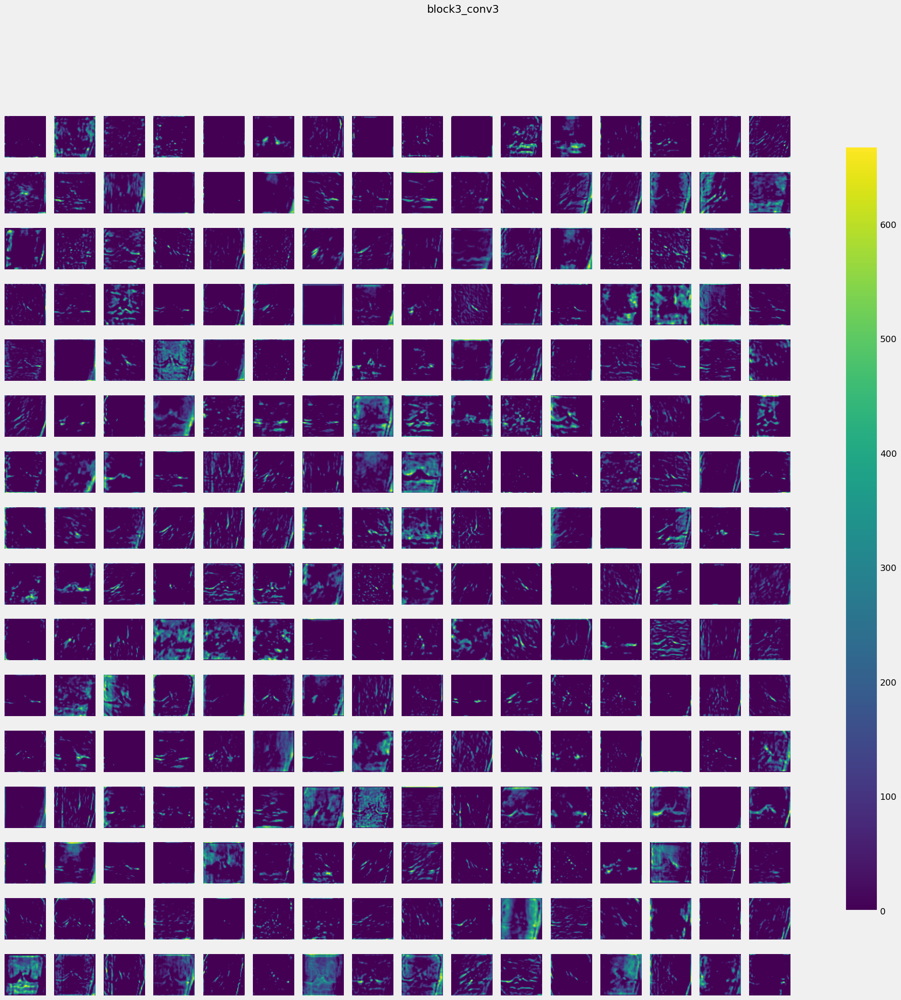

block3_pool (1, 28, 28, 256) 


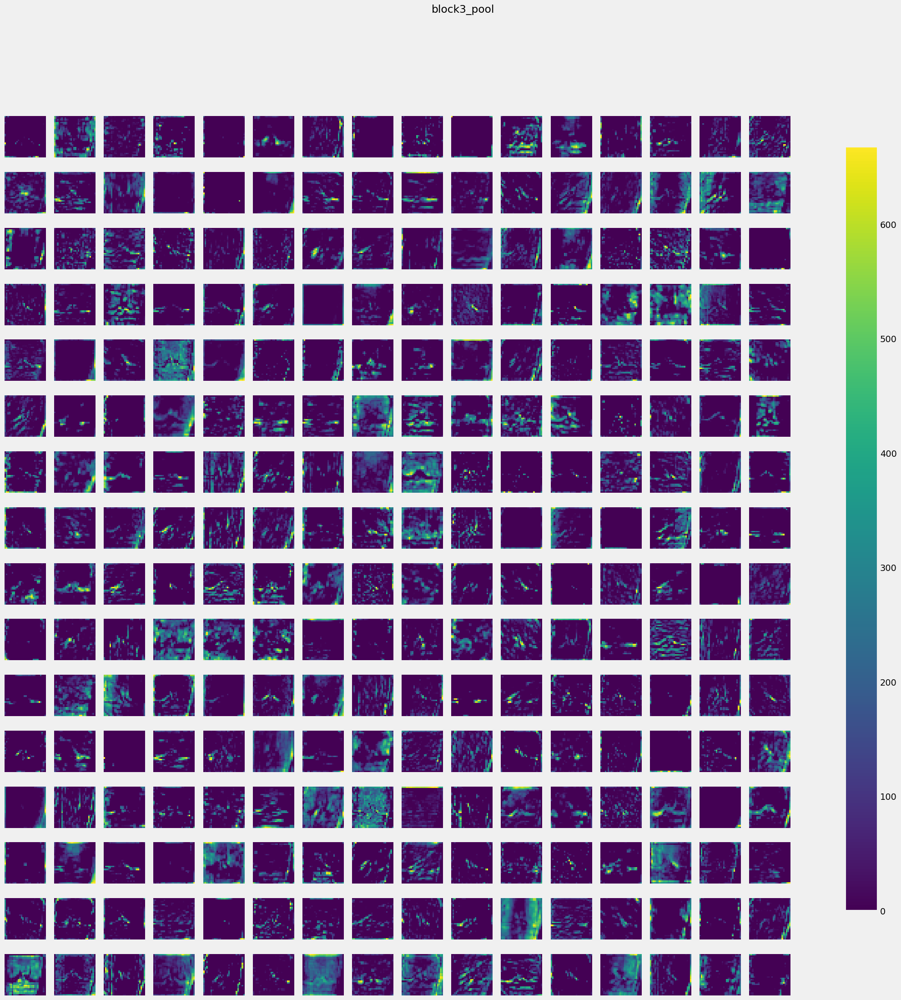

block4_conv1 (1, 28, 28, 512) 


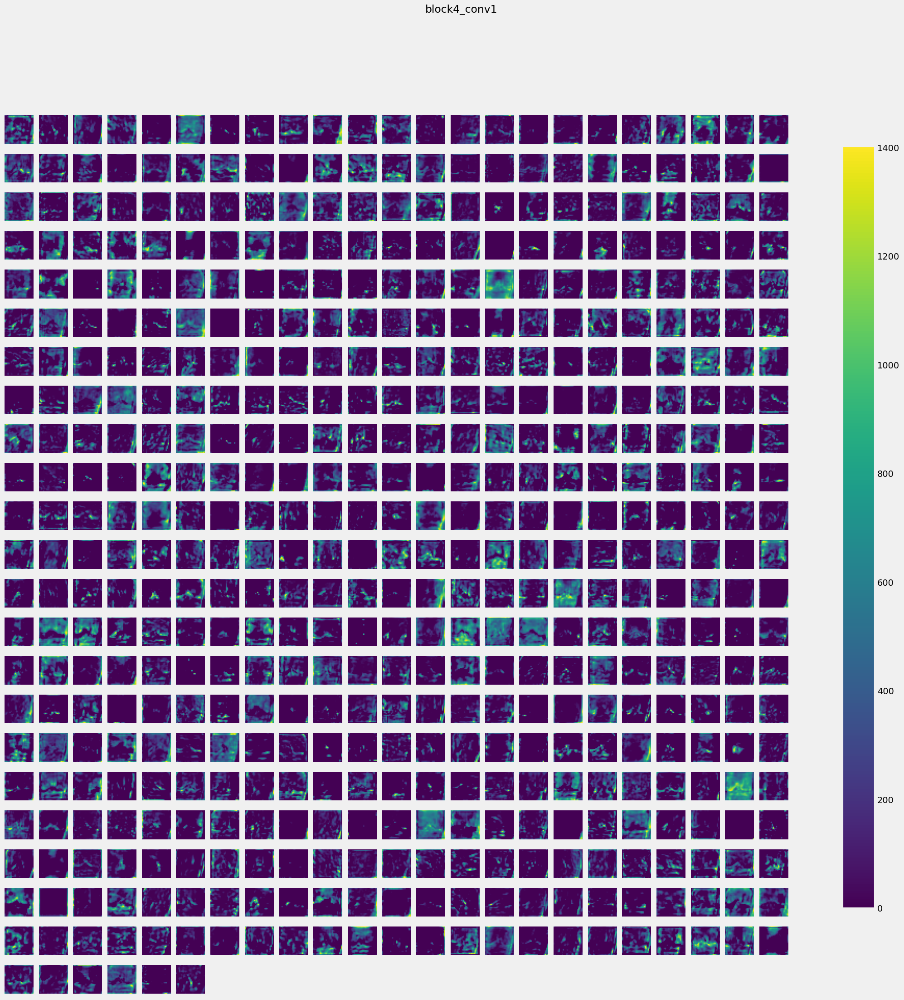

block4_conv2 (1, 28, 28, 512) 


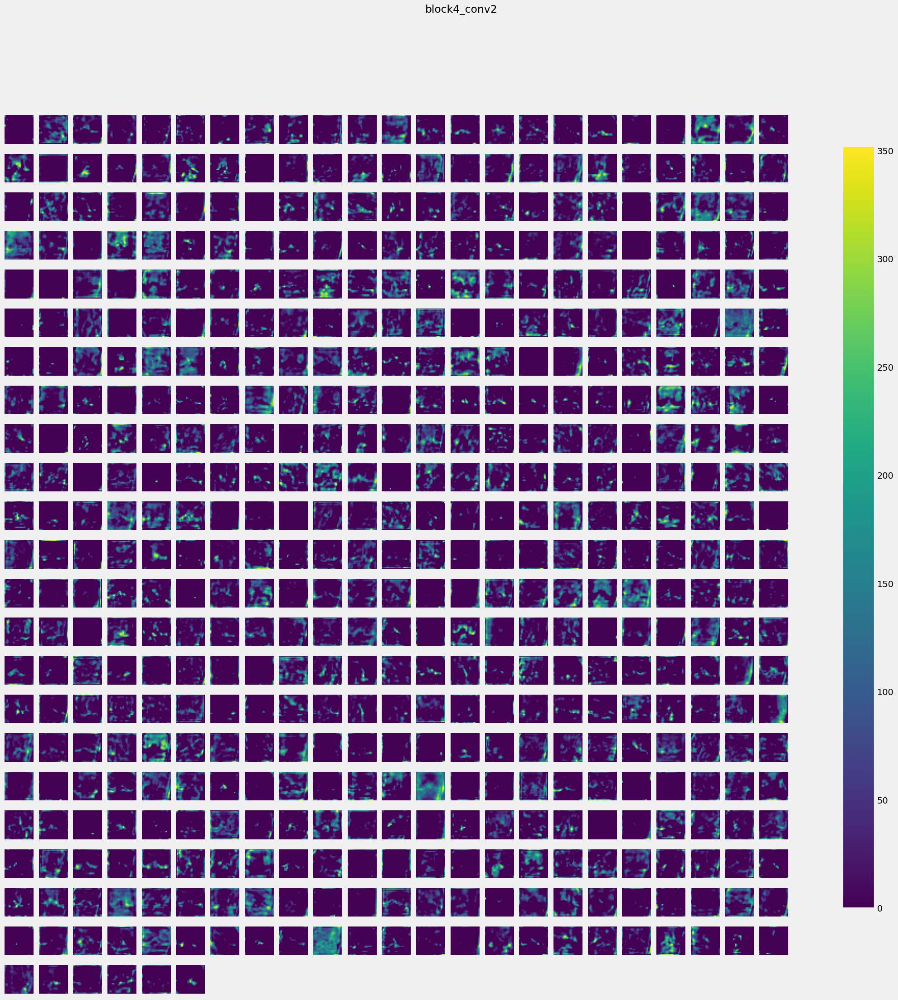

block4_conv3 (1, 28, 28, 512) 


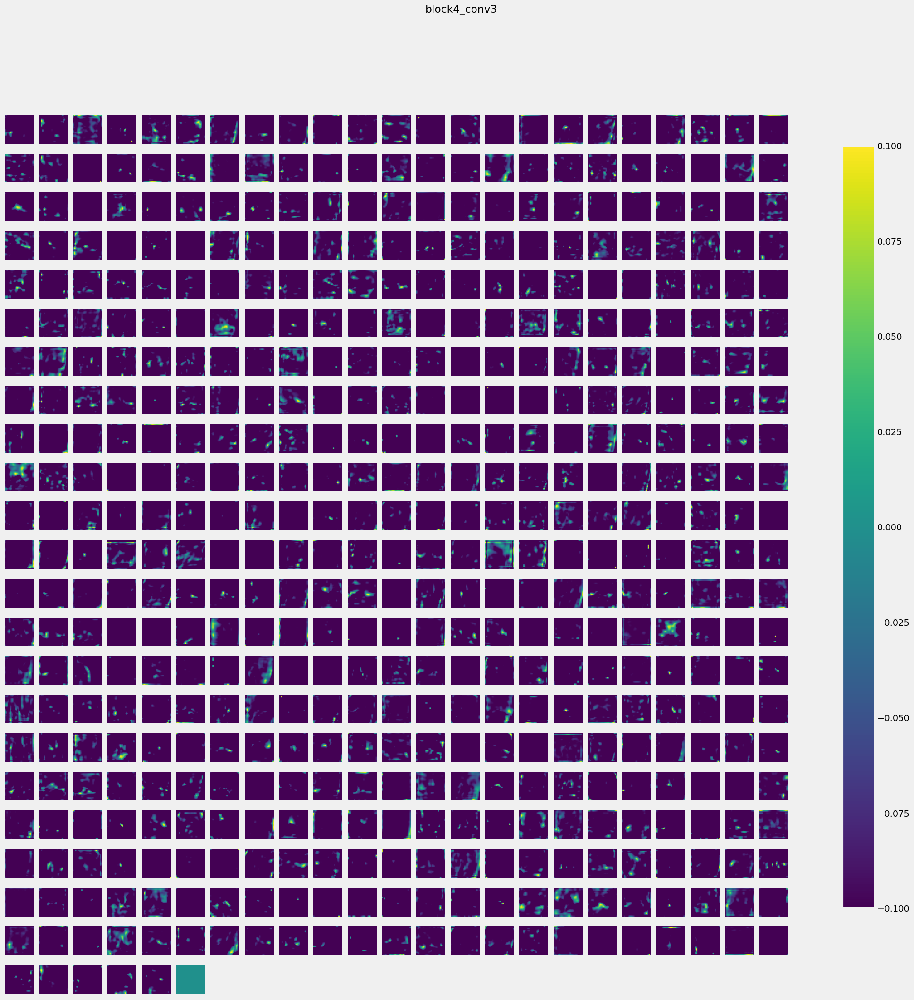

block4_pool (1, 14, 14, 512) 


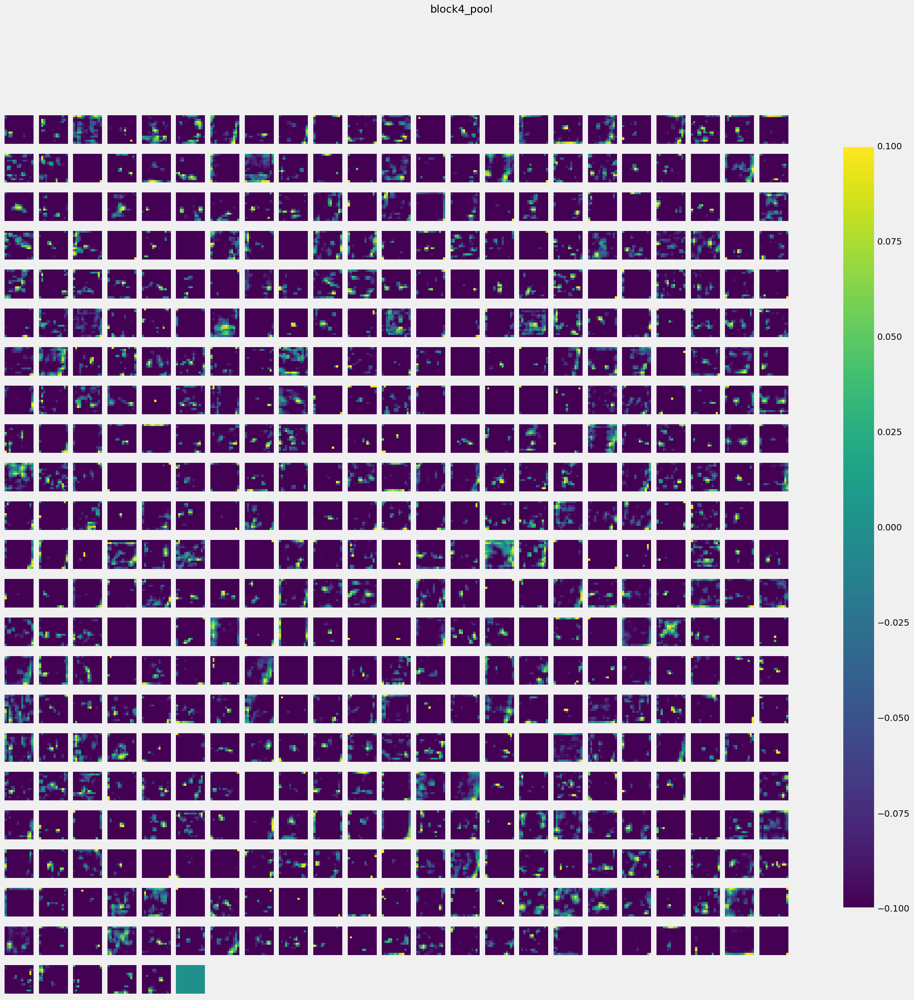

block5_conv1 (1, 14, 14, 512) 


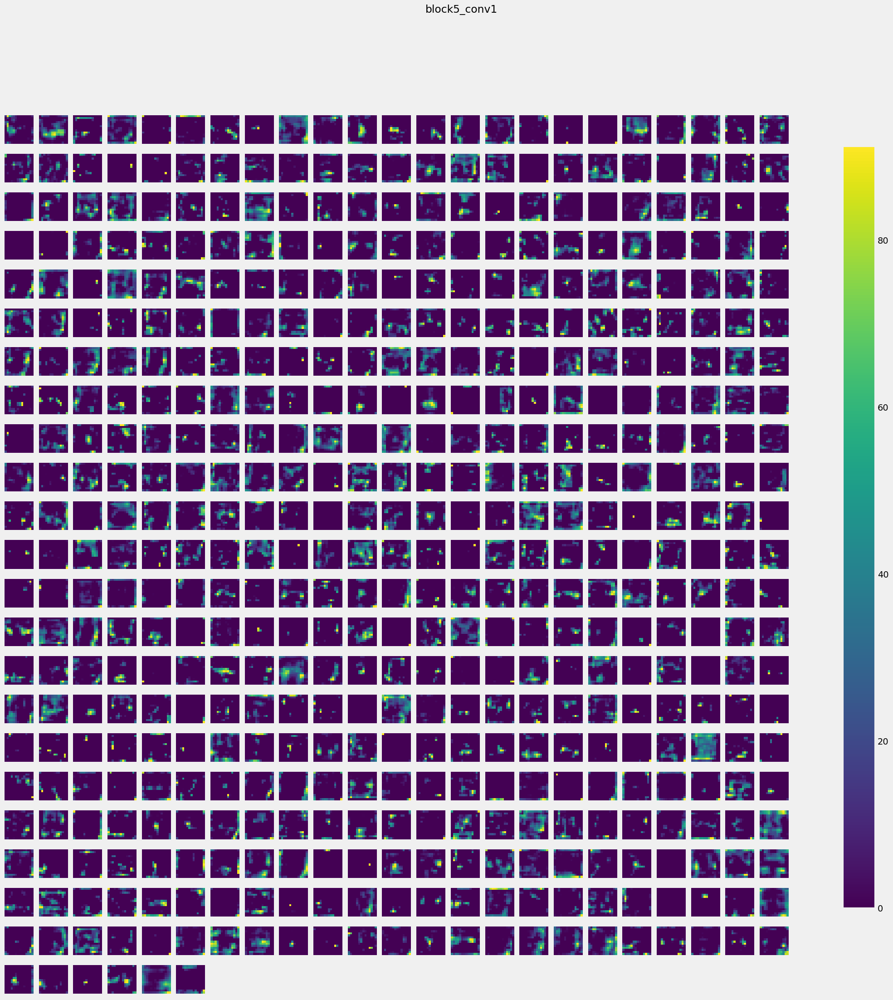

block5_conv2 (1, 14, 14, 512) 


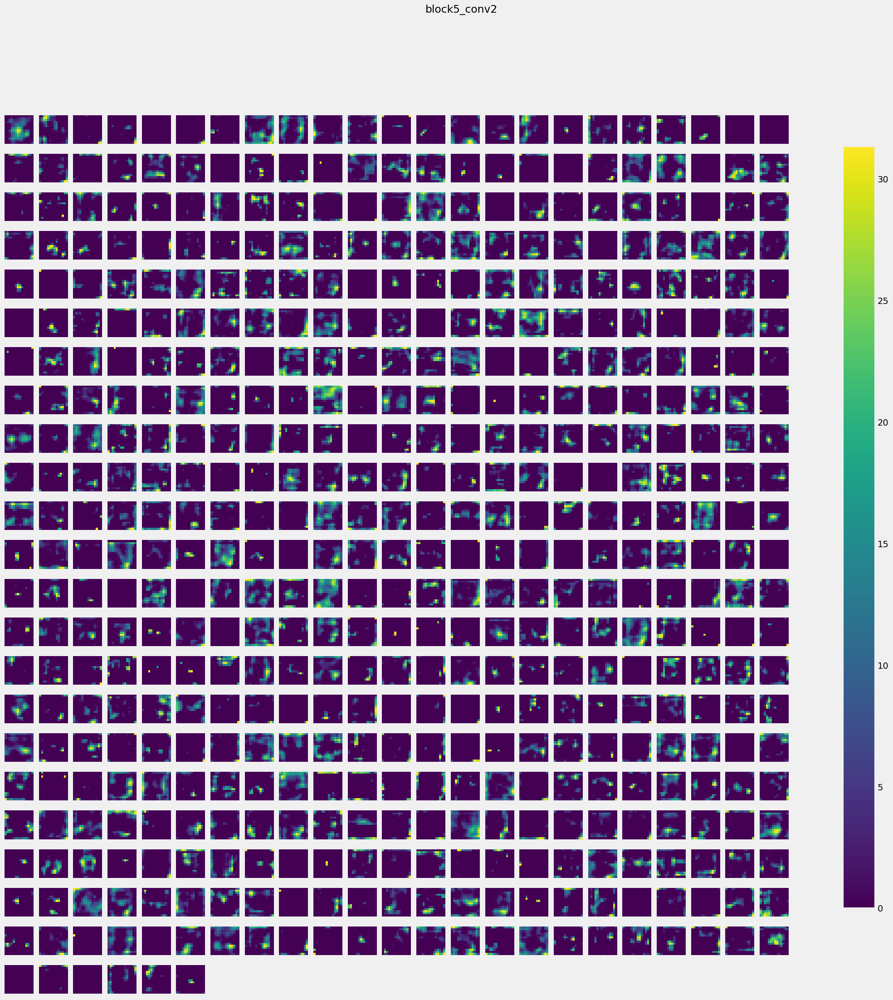

block5_conv3 (1, 14, 14, 512) 


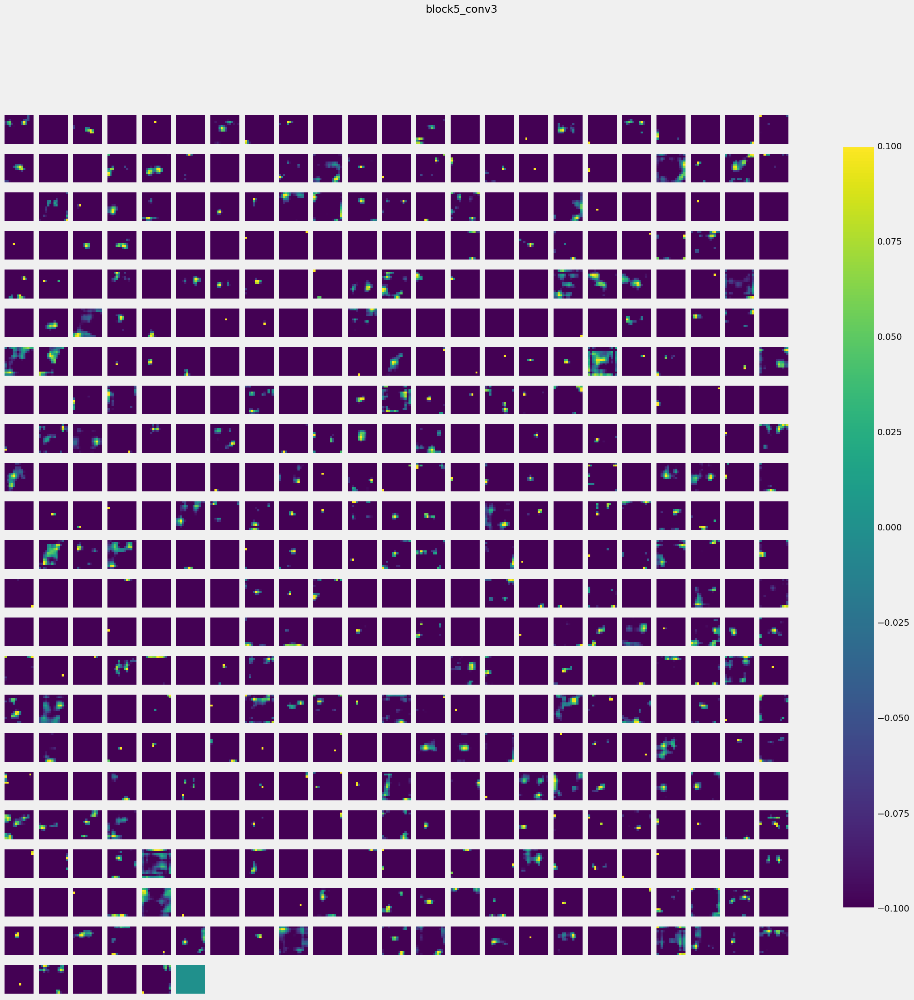

block5_pool (1, 7, 7, 512) 


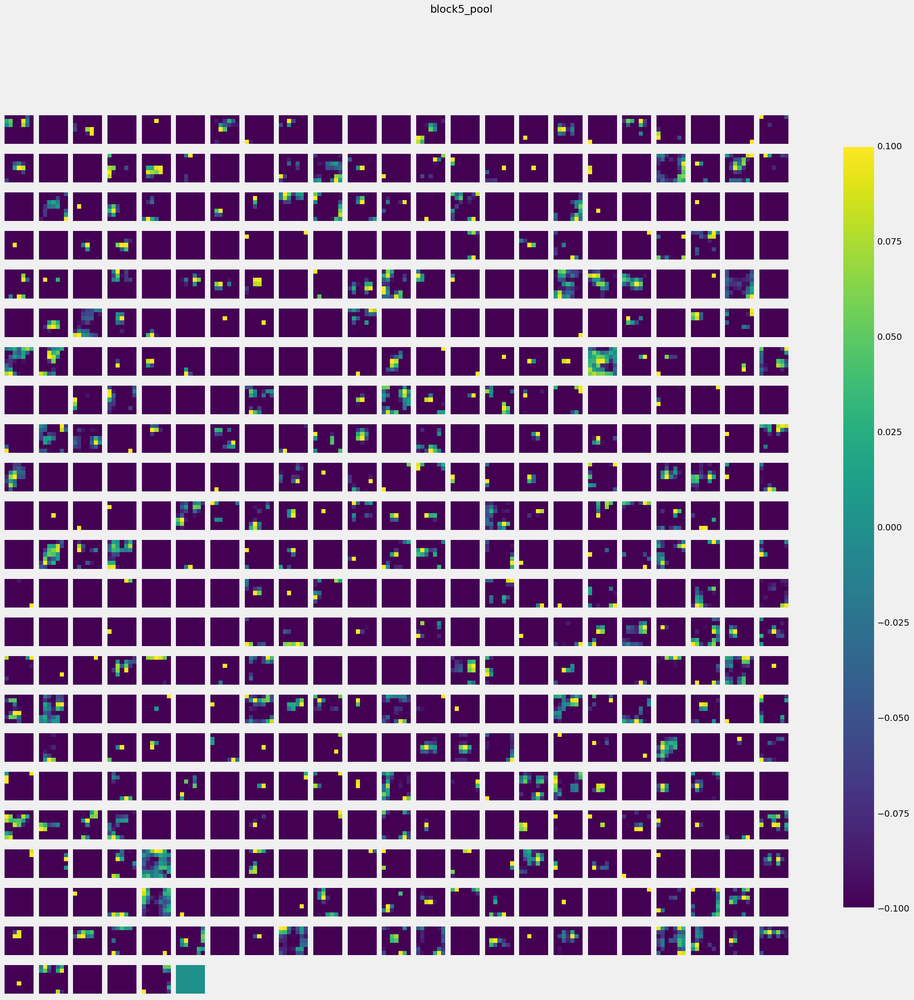

flatten (1, 25088) 


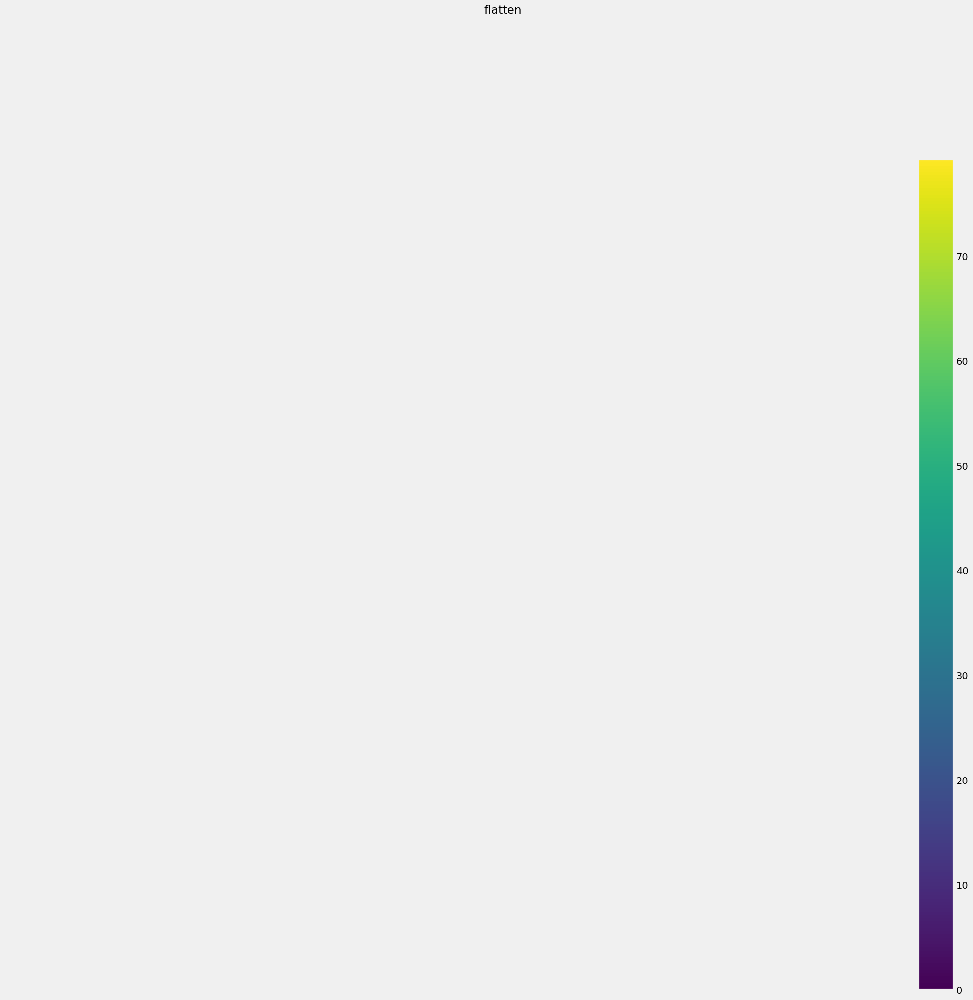

fc1 (1, 4096) 


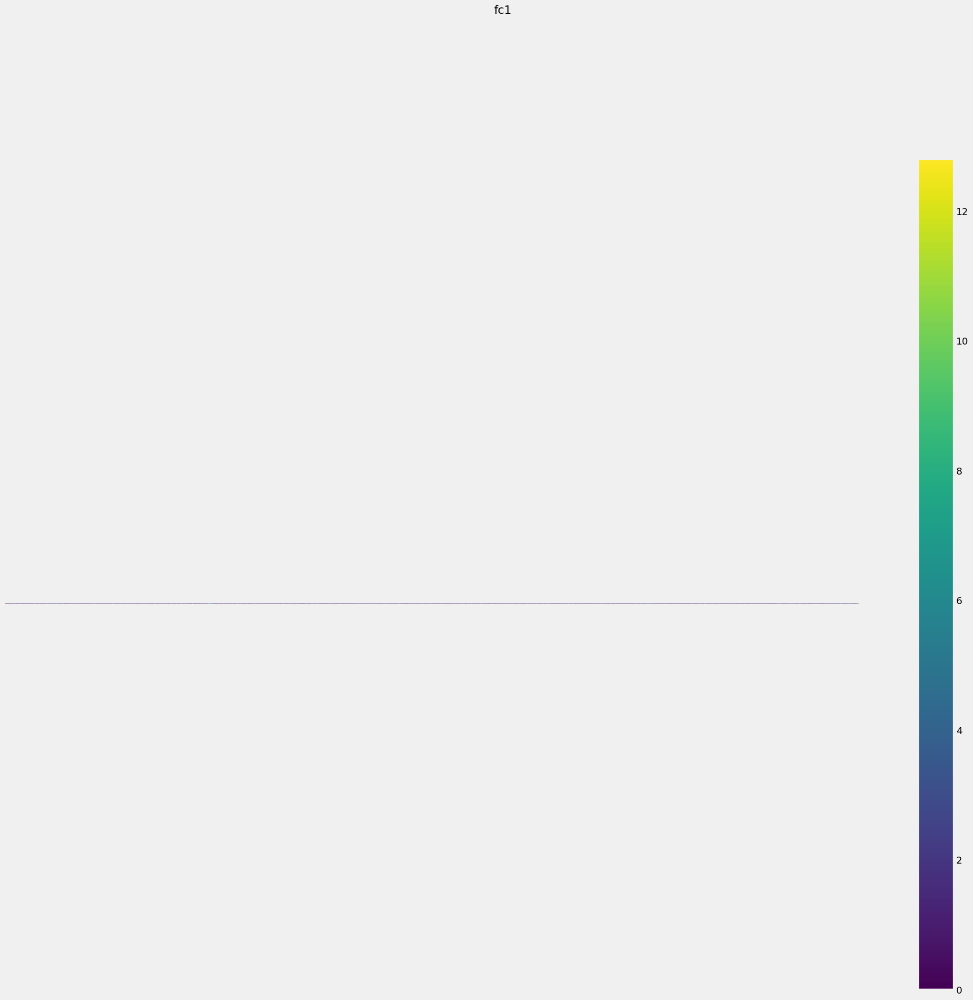

fc2 (1, 4096) 


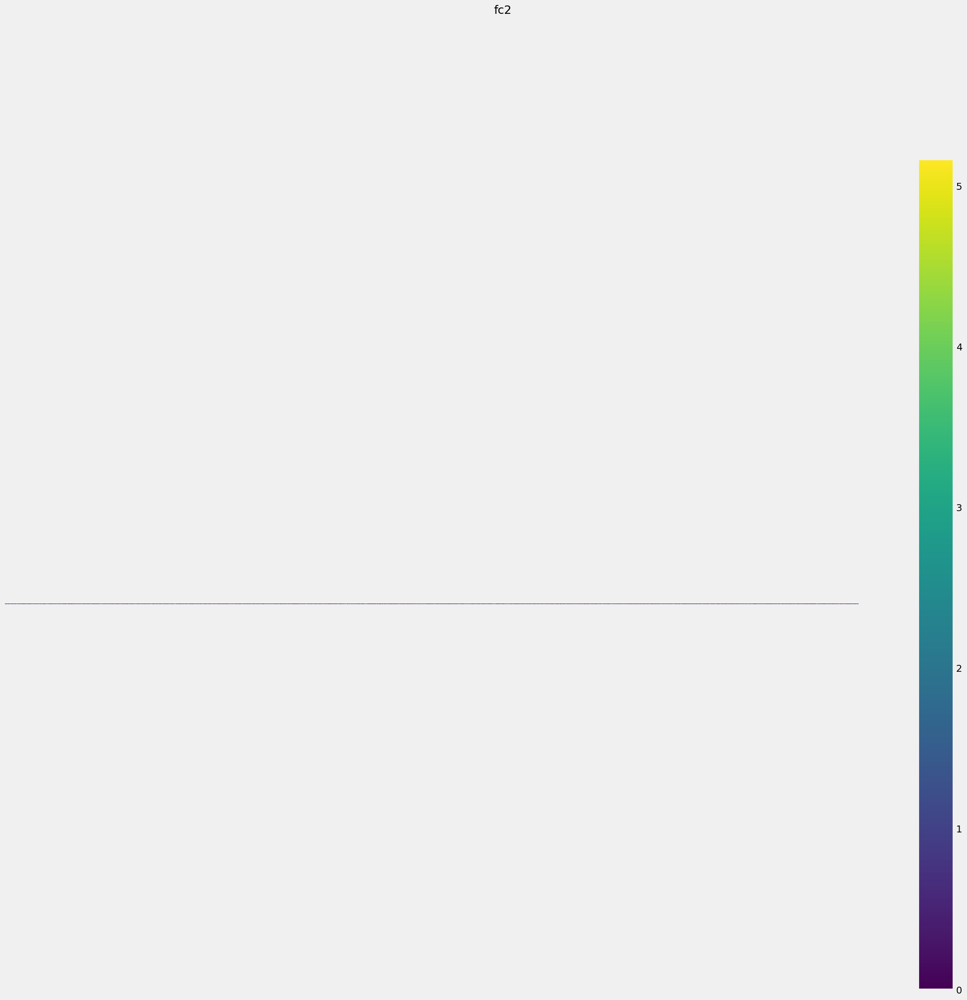

predictions (1, 1000) 


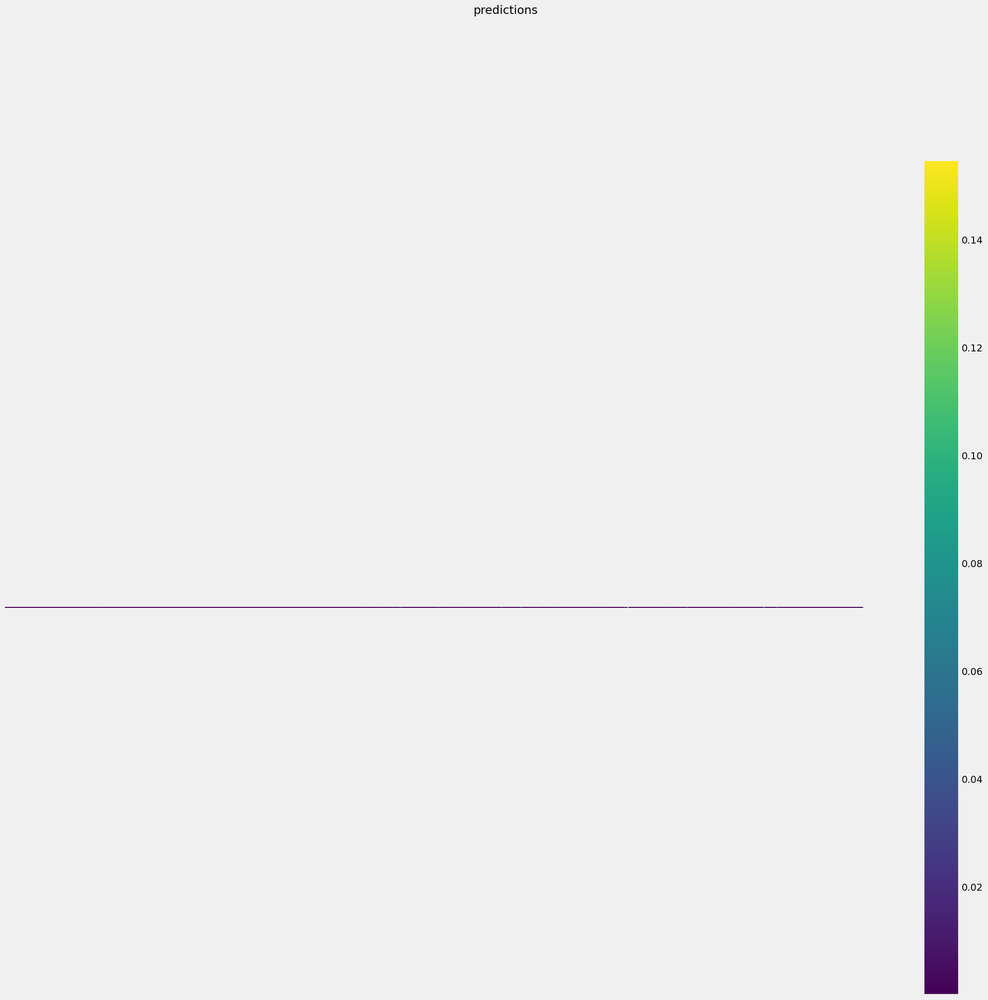

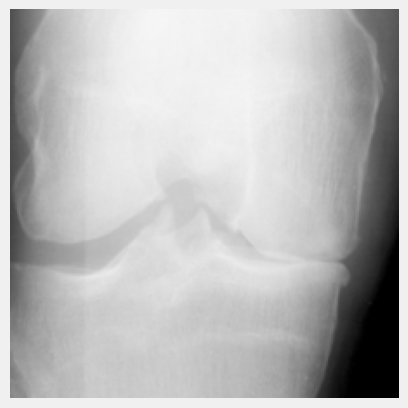

In [ ]:

# Load an image
img_path = "/content/test/4/9012867R.png"
img = load_img(img_path, target_size=(224, 224))
img = img_to_array(img)
img = preprocess_input(img)
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))

# Get activations for all layers
activations = get_activations(model, img)

# Display activations for a few layers (adjust layer_names as needed)
layer_names = ["block1_conv1", "block2_conv2", "block3_conv3", "block4_conv3", "block5_conv3", "fc1", "predictions"]
display_activations(activations, cmap="viridis", save=False)

# Visualize the original image
plt.imshow(load_img(img_path))
plt.axis('off')
plt.show()